In [15]:
import pygmt
import pandas as pd
import numpy as np
from obspy.clients.fdsn import Client
from obspy.core.utcdatetime import UTCDateTime
import datetime
import tempfile



In [16]:
year = 'swa_shore'
# Load the catalogs 
matched_events_mycatalog2morton= pd.read_csv(f'../data/datasets_{year}/matched_events_with_morton_mycatalog.csv')
unmatched_events_mycatalog2morton_and_anss= pd.read_csv(f'../data/datasets_{year}/new_events_filtered_{year}.csv')
# new_events_filtered = pd.read_csv('../data/datasets_2014/new_events_filtered.csv')
unmatched_events_morton2mycatalog= pd.read_csv(f'../data/datasets_{year}/missing_events_from_mycatalog_morton.csv')
matched_events_morton2mycatalog= pd.read_csv(f'../data/datasets_{year}/matched_events_with_mycatalog_morton.csv')
unmatched_events_anss2mycatalog = pd.read_csv(f'../data/datasets_{year}/missing_events_from_mycatalog_anss.csv')
matched_events_mycatalog2anss= pd.read_csv(f'../data/datasets_{year}/matched_events_with_anss_mycatalog.csv')
matched_events_anss2mycatalog= pd.read_csv(f'../data/datasets_{year}/matched_events_with_mycatalog_anss.csv')

anss_events = pd.read_csv('../data/anss_2011-15.csv')


## Load Station Information

In [17]:
all_picks = pd.read_csv(f'../data/datasets_{year}/all_picks_all_years_for_assoc_{year}.csv')
# all_picks_for_picking = pd.read_csv(f'../data/datasets_{year}/all_picks_{year}_for_picking.csv')
all_pick_assignments = pd.read_csv(f'../data/datasets_{year}/all_pick_assignments_{year}.csv')
all_pick_assignments

,Unnamed: 0,idx,time,x,y,z,picks,latitude,longitude,depth,event_idx,pick_idx,residual,station,phase,time_pick
0,0,8,2014-01-01 05:17:38.794816+00:00,149.322069,333.854869,49.609375,6,47.486485,-123.518593,49.609375,8,1169808,-0.364817,FN03C,S,1.388553e+09
1,1,8,2014-01-01 05:17:38.794816+00:00,149.322069,333.854869,49.609375,6,47.486485,-123.518593,49.609375,8,598706,0.539194,FN05C,P,1.388553e+09
2,2,8,2014-01-01 05:17:38.794816+00:00,149.322069,333.854869,49.609375,6,47.486485,-123.518593,49.609375,8,653150,0.309188,FN19C,P,1.388553e+09
3,3,8,2014-01-01 05:17:38.794816+00:00,149.322069,333.854869,49.609375,6,47.486485,-123.518593,49.609375,8,1548993,1.285727,FN19C,S,1.388553e+09
4,4,8,2014-01-01 05:17:38.794816+00:00,149.322069,333.854869,49.609375,6,47.486485,-123.518593,49.609375,8,1457818,-0.976911,J49C,S,1.388553e+09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4522,4522,6359,2014-06-25 20:47:18.688608+00:00,50.338034,270.433987,1.953125,6,46.931239,-124.838992,1.953125,6359,807548,-0.612264,FN04C,P,1.403729e+09
4523,4523,6359,2014-06-25 20:47:18.688608+00:00,50.338034,270.433987,1.953125,6,46.931239,-124.838992,1.953125,6359,1723953,0.570819,FN04C,S,1.403729e+09
4524,4524,6359,2014-06-25 20:47:18.688608+00:00,50.338034,270.433987,1.953125,6,46.931239,-124.838992,1.953125,6359,1468531,-0.254963,FN05C,S,1.403729e+09
4525,4525,6359,2014-06-25 20:47:18.688608+00:00,50.338034,270.433987,1.953125,6,46.931239,-124.838992,1.953125,6359,701629,0.603309,J49C,P,1.403729e+09


### Station info for stations used after association 

In [7]:
available_networks = ','.join(all_picks['station_network_code'].drop_duplicates().values)
available_networks

'7D,UW'

In [8]:
stations = all_pick_assignments['station'].drop_duplicates().values
len(stations)

8

In [9]:
# Obtain the latitudes of longitude of the stations used
client = Client("IRIS")

sta_lat = []
sta_lon = []
sta_names = []

for station in stations:

    # Fetch the station inventory
    inventory = client.get_stations(network=available_networks, station=station, level='station')

    # The correct path to access the station's latitude and longitude
    _sta_lat = inventory[0][0].latitude
    _sta_lon = inventory[0][0].longitude
    
    sta_lat.append(_sta_lat)
    sta_lon.append(_sta_lon)
    sta_names.append(inventory.networks[0].code+'.'+station)

In [10]:
# Append the number of picks for each station to a list
# Create a list of stations 
ls_sta = stations
# Create a list that contain the number of picks for each station
num_picks = []
for i in ls_sta:
    _num_picks = len(all_picks[all_picks['station_code']==i])
    num_picks.append(_num_picks)

In [18]:
del all_picks

### Station info for original stations for picking

In [33]:
available_stations = np.array(all_picks_for_picking[['station_network_code','station_code']].drop_duplicates(subset='station_code'))
len(available_stations)

151

In [34]:
# arr_available_stations = np.array(available_stations)
# arr_available_stations

In [35]:
# np.unique(arr_available_stations[:,0])

In [36]:
# # Obtain the latitudes of longitude of the stations used
# client = Client("IRIS")

# sta_7D_lat = []
# sta_7D_lon = []
# other_sta_lat = []
# other_sta_lon = []
# for network, station in available_stations:

#     # Fetch the station inventory
#     inventory = client.get_stations(network=network, station=station, level='station')

#     # The correct path to access the station's latitude and longitude
#     sta_lat = inventory[0][0].latitude
#     sta_lon = inventory[0][0].longitude

#     # Check if the station belongs to network '7D'
#     if network == '7D':
#         sta_7D_lat.append(sta_lat)
#         sta_7D_lon.append(sta_lon)
#     else:
#         other_sta_lat.append(sta_lat)
#         other_sta_lon.append(sta_lon)



In [37]:
# Obtain the latitudes of longitude of the stations used
client = Client("IRIS")

sta_lat1 = []
sta_lon1 = []
sta_names1 = []

for network, station in available_stations:

    # Fetch the station inventory
    inventory = client.get_stations(network=network, station=station, level='station')

    # The correct path to access the station's latitude and longitude
    _sta_lat1 = inventory[0][0].latitude
    _sta_lon1 = inventory[0][0].longitude
    
    sta_lat1.append(_sta_lat1)
    sta_lon1.append(_sta_lon1)
    sta_names1.append(network+'.'+station)

In [38]:
len(sta_names1)

151

In [39]:
# Append the number of picks for each station to a list
# Create a list of stations 
ls_sta1 = all_picks_for_picking.drop_duplicates(subset='station_code')['station_code'].values
# Create a list that contain the number of picks for each station
num_picks1 = []
for i in ls_sta1:
    _num_picks1 = len(all_picks_for_picking[all_picks_for_picking['station_code']==i])
    num_picks1.append(_num_picks1)

In [40]:
del all_picks_for_picking,all_pick_assignments

In [41]:
# Obtain the latitudes and longitudes of the ANSS events
anss_events_lat = anss_events['latitude']
anss_events_lon = anss_events['longitude']

## Station Map
Plot only the stations that have picks for the newly found events

### Station map for stations used after association 

plot [WARNING]: Cannot use auto-legend -l for variable symbol color. Option -l ignored.


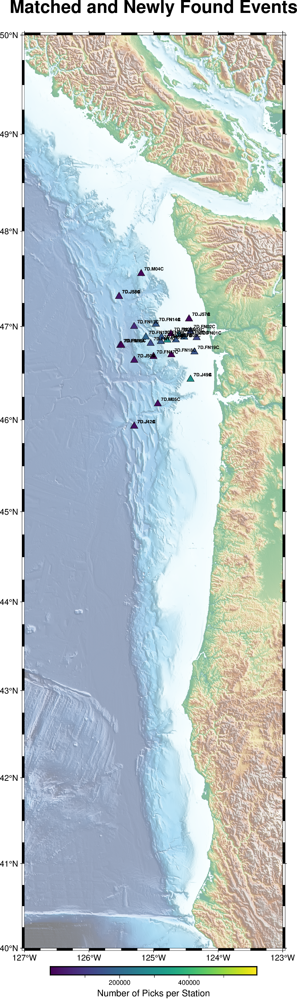

In [17]:
# Initialize the figure
fig = pygmt.Figure()

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[-127, -123, 40, 50])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Define target region
region = [-127, -123, 40, 50]
title = "Matched and Newly Found Events"
fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo", shading=shade, transparency=50)
pygmt.makecpt(cmap="viridis", series=[min(num_picks), max(num_picks)])

# Plot stations
fig.plot(x=sta_lon, y=sta_lat, fill=num_picks, style="t0.4c", pen="black", cmap=True, label="Stations")
fig.colorbar(frame="xaf+lNumber of Picks per Station")

# Plot station names with arrows
for lon, lat, name in zip(sta_lon, sta_lat, sta_names):
    # Adjust the offset for the text position
    text_lon = lon + 0.05
    text_lat = lat + 0.05
    
    # Draw an arrow from the station to the text position
    fig.plot(x=[lon, text_lon], y=[lat, text_lat], pen="1p,black", style="v0.2c+e")
    
    # Place the station name at the adjusted position
    fig.text(x=text_lon, y=text_lat, text=name, font="6p,Helvetica-Bold,black", justify="ML")

# Add a legend to the plot
# fig.legend(position="JTR+w9+jTR", box='+gwhite+p1p')

# Save and display the figure
fig.savefig(f"station_map_{year}_for_assoc.pdf")
fig.show()


### Station map for stations used for phase picking

plot [WARNING]: Cannot use auto-legend -l for variable symbol color. Option -l ignored.


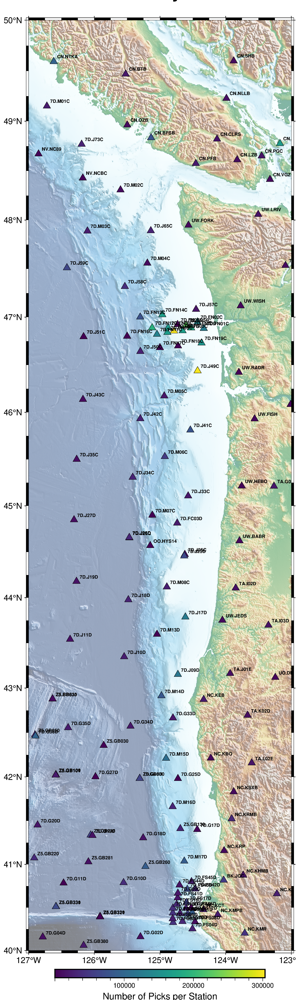

In [43]:
# Initialize the figure
fig = pygmt.Figure()

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[-127, -123, 40, 50])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Define target region
region = [-127, -123, 40, 50]
title = "Matched and Newly Found Events"
fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo", shading=shade, transparency=50)
pygmt.makecpt(cmap="viridis", series=[min(num_picks1), max(num_picks1)])

# Plot stations
fig.plot(x=sta_lon1, y=sta_lat1, fill=num_picks1, style="t0.4c", pen="black", cmap=True, label="Stations")
fig.colorbar(frame="xaf+lNumber of Picks per Station")

# Plot station names with arrows
for lon, lat, name in zip(sta_lon1, sta_lat1, sta_names1):
    # Adjust the offset for the text position
    text_lon = lon + 0.05
    text_lat = lat + 0.05
    
    # Draw an arrow from the station to the text position
    fig.plot(x=[lon, text_lon], y=[lat, text_lat], pen="1p,black", style="v0.2c+e")
    
    # Place the station name at the adjusted position
    fig.text(x=text_lon, y=text_lat, text=name, font="6p,Helvetica-Bold,black", justify="ML")

# Add a legend to the plot
# fig.legend(position="JTR+w9+jTR", box='+gwhite+p1p')

# Save and display the figure
fig.savefig(f"station_map_{year}_for_picking.pdf")
fig.show()


## Load the nodes information for assocation by region

In [12]:
nodes = pd.read_csv(f'../data/datasets_{year}/nodes_{year}.csv')
nodes

,Unnamed: 0,node,latitude_deg,latitude_min,longitude_deg,longitude_min,radius,buffer_zone,velocity_model_id,latitude,longitude
0,0,nod,46,12.0,124,15.0,15,15,6,46.20,-124.250000
1,1,nod,46,21.0,124,15.0,15,15,6,46.35,-124.250000
2,2,nod,46,30.0,124,20.0,15,15,6,46.50,-124.333333
3,3,nod,46,39.0,124,20.0,15,15,6,46.65,-124.333333
4,4,nod,46,48.0,124,20.0,15,15,6,46.80,-124.333333
5,5,nod,46,57.0,124,20.0,15,15,6,46.95,-124.333333
6,6,nod,47,6.0,124,25.0,15,15,6,47.10,-124.416667


## Final map on the poster

/tmp/ipykernel_1733210/2993237691.py:29: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/2993237691.py:29: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/2993237691.py:29: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/2993237691.py:29: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/2993237691.py:29: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/2993237691.py:29: FutureWarning: The 'color' parameter has been dep

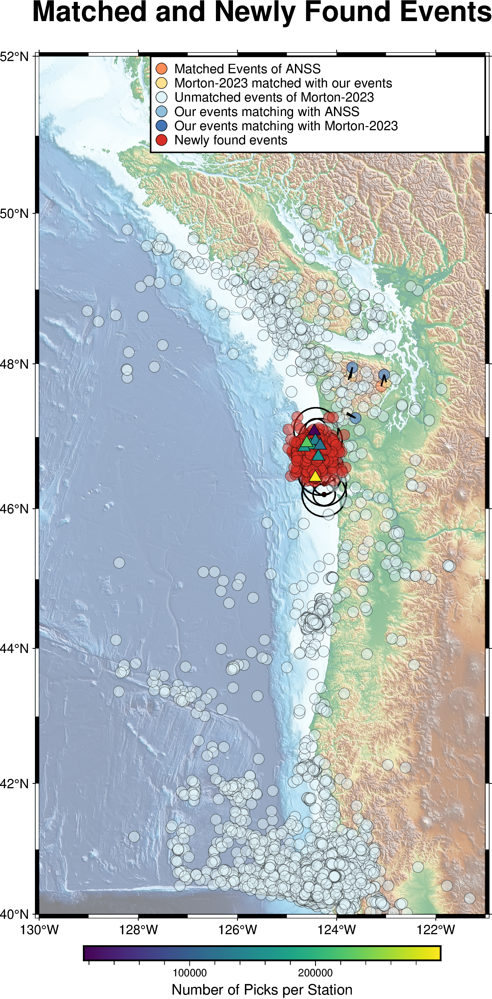

In [19]:
fig = pygmt.Figure()

# Define target region
min_lat= 40
max_lat=52

min_lon=-130
max_lon=-121

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

region = [min_lon, max_lon, min_lat, max_lat]
title = "Matched and Newly Found Events"
fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo",shading=shade, transparency=50)
pygmt.makecpt(cmap="viridis", series=[min(num_picks), max(num_picks)])

# Adjust plot calls to use 'style' correctly
# PLot the stations
# fig.plot(x=sta_lon, y=sta_lat,  
#          fill='black', style="t0.4c", pen="black", label="Stations")
# fig.plot(x=other_sta_lon, y=other_sta_lat,  
#          fill='white', style="t0.4c", pen="black", label="Other Stations")

# Draw circles at the nodes
for idx, row in nodes.iterrows():
    fig.plot(
        x=row["longitude"],
        y=row["latitude"],
        style="c0.1c",  # Circle with 0.5 cm radius
        color="red",
        pen="1p,black"
    )
    fig.plot(
        x=row["longitude"],
        y=row["latitude"],
        style=f"c{row['radius']/((max_lon-min_lon)*2.8)}c",# Circle with radius in km
        pen="1p,black"
    )
    fig.plot(
            x=row["longitude"],
            y=row["latitude"],
            style=f"c{(row['radius'] + row['buffer_zone']) / ((max_lon - min_lon) * 2.8)}c",  # Circle with radius in km
            pen=f"1p,black"
        )
    
# Plotting data points


fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.3c", color='#fc8d59', pen="black",  transparency=50,label='Matched Events of ANSS')

fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.3c", color='#fee090', pen="black",  transparency=50,label='Morton-2023 matched with our events')
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.3c", color='#e0f3f8', pen="black",  transparency=50,label='Unmatched events of Morton-2023')
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.3c", color='#91bfdb', pen="black",  transparency=50,label='Our events matching with ANSS')
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.3c", color='#4575b4', pen="black",  transparency=50,label='Our events matching with Morton-2023')
fig.plot(x=unmatched_events_mycatalog2morton_and_anss['longitude'], y=unmatched_events_mycatalog2morton_and_anss['latitude'],  
         style="c0.3c", color='#d73027', pen="black", transparency=50, label='Newly found events')
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="1p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="1p,black"
    )

# fig.plot(x=sta_lon, y=sta_lat,  
#          fill='gray', style="t0.4c", pen="black", label="Stations")

# Plot stations
cmap = 'viridis'
fig.plot(x=sta_lon, y=sta_lat, fill=num_picks, style="t0.4c", pen="black", cmap=True, label="Stations")
fig.colorbar(frame="xaf+lNumber of Picks per Station")

# Add a legend to the plot
fig.legend(position="JTR+w9+jTR", box='+gwhite+p1p')
fig.savefig(f"matched_and_newly_found_Events_{year}_filtered.pdf")
# Display the figure
fig.show()



### Plot the same map above with a representation of picks by size

/tmp/ipykernel_1733210/3053661312.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/3053661312.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/3053661312.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/3053661312.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/3053661312.py:33: FutureWarning: The 'color' parameter has been deprecated since v0.8.0 and will be removed in v0.12.0. Please use 'fill' instead.
  fig.plot(
/tmp/ipykernel_1733210/3053661312.py:33: FutureWarning: The 'color' parameter has been dep

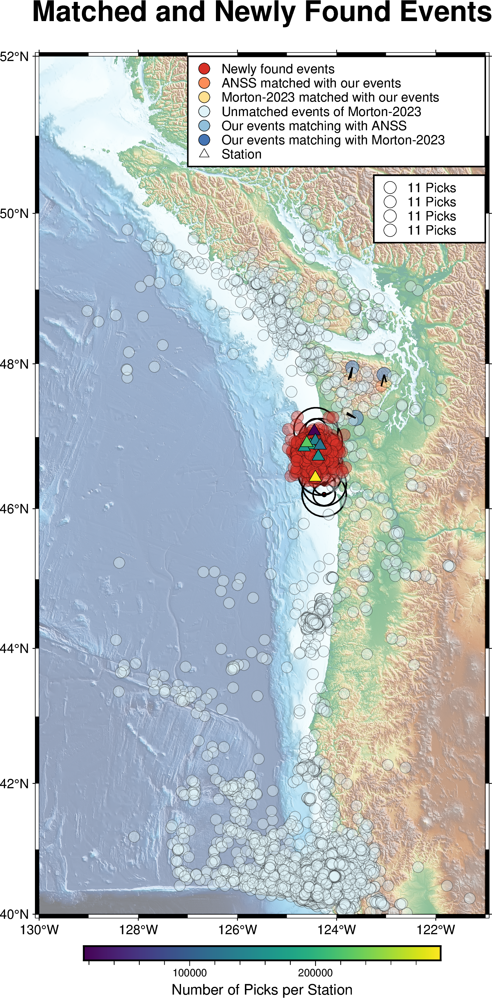

In [20]:
# Define the number of picks
picks_new_events = unmatched_events_mycatalog2morton_and_anss['picks']
picks_mycatalog2anss = matched_events_mycatalog2anss['picks']
picks_mycatalog2morton = matched_events_mycatalog2morton['picks']

#Parameters
# Define target region
min_lat= 40
max_lat=52

min_lon=-130
max_lon=-121

# Plotting parameters
transparency = 60

# Initialize the figure
fig = pygmt.Figure()

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[min_lon, max_lon, min_lat, max_lat])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Define target region
region = [min_lon, max_lon, min_lat, max_lat]
title = "Matched and Newly Found Events"
fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo", shading=shade, transparency=50)
pygmt.makecpt(cmap="viridis", series=[min(num_picks), max(num_picks)])

# Draw circles at the nodes
for idx, row in nodes.iterrows():
    fig.plot(
        x=row["longitude"],
        y=row["latitude"],
        style="c0.1c",  # Circle with 0.5 cm radius
        color="red",
        pen="1p,black"
    )
    fig.plot(
        x=row["longitude"],
        y=row["latitude"],
        style=f"c{row['radius']/((max_lon-min_lon)*2.8)}c",# Circle with radius in km
        pen="1p,black"
    )
    fig.plot(
            x=row["longitude"],
            y=row["latitude"],
            style=f"c{(row['radius'] + row['buffer_zone']) / ((max_lon - min_lon) * 2.8)}c",  # Circle with radius in km
            pen=f"1p,black"
        )

# Plotting data points with dynamic transparency and sizes

fig.plot(
    x=matched_events_mycatalog2anss['longitude'],
    y=matched_events_mycatalog2anss["latitude"],
    size=0.03 * (matched_events_mycatalog2anss['picks']+5),
    style="c", color='#91bfdb', pen="black",transparency=transparency,
    label='Our events matching with ANSS'
)
fig.plot(
    x=matched_events_mycatalog2morton['longitude'],
    y=matched_events_mycatalog2morton['latitude'],
    size=0.03 * (matched_events_mycatalog2morton['picks']+5),
    style="c", color='#4575b4', pen="black",transparency=transparency,
    label='Our events matching with Morton-2023'
)
fig.plot(
    x=matched_events_anss2mycatalog['longitude'],
    y=matched_events_anss2mycatalog['latitude'],
    style="c0.3c", color='#fc8d59', pen="black",transparency=transparency,
    label='ANSS matched with our events'
)
fig.plot(
    x=matched_events_morton2mycatalog['LON'],
    y=matched_events_morton2mycatalog['LAT'],
    style="c0.3c", color='#fee090', pen="black",transparency=transparency,
    label='Morton-2023 matched with our events'
)
fig.plot(
    x=unmatched_events_morton2mycatalog['LON'],
    y=unmatched_events_morton2mycatalog["LAT"],
    style="c0.3c", color='#e0f3f8', pen="black",transparency=transparency,
    label='Unmatched events of Morton-2023'
)


# Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="1p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="1p,black"
    )
fig.plot(
    x=unmatched_events_mycatalog2morton_and_anss['longitude'],
    y=unmatched_events_mycatalog2morton_and_anss['latitude'],
    size=0.03 * (unmatched_events_mycatalog2morton_and_anss['picks']+5),
    style="c", color='#d73027', pen="black", transparency=transparency,
    label='Newly found events'
)

# fig.plot(x=sta_lon, y=sta_lat, fill='white', style="t0.4c", pen="black", label="Stations")

# Plot stations
fig.plot(x=sta_lon, y=sta_lat, fill=num_picks, style="t0.4c", pen="black", cmap=True, label="Stations")
fig.colorbar(frame="xaf+lNumber of Picks per Station")

legend_entries = """
S 0.3c c 0.3c #d73027 0.25p 0.3i Newly found events
S 0.3c c 0.3c #fc8d59 0.25p 0.3i ANSS matched with our events
S 0.3c c 0.3c #fee090 0.25p 0.3i Morton-2023 matched with our events
S 0.3c c 0.3c #e0f3f8 0.25p 0.3i Unmatched events of Morton-2023
S 0.3c c 0.3c #91bfdb 0.25p 0.3i Our events matching with ANSS 
S 0.3c c 0.3c #4575b4 0.25p 0.3i Our events matching with Morton-2023
S 0.3c t 0.3c white 0.25p 0.3i Station
"""

# Write legend entries to a temporary file
with tempfile.NamedTemporaryFile(mode='w+', delete=False) as tmpfile:
    tmpfile.write(legend_entries)
    tmpfile_path = tmpfile.name
    
# Add a legend for the pick scale to the plot
fig.legend(spec=tmpfile_path,position="JTR+w8+jTR", box='+gwhite+p1p')

sizes = (np.linspace(unmatched_events_mycatalog2morton_and_anss['picks'].min(), unmatched_events_mycatalog2morton_and_anss['picks'].max(), 22)+5) * 0.03

legend_entries = f"""
S 0.3c c {sizes[0]:.2f}c white 0.25p 0.3i {round(sizes[0]/0.03)} Picks
S 0.3c c {sizes[1]:.2f}c white 0.25p 0.3i {round(sizes[1]/0.03)} Picks
S 0.3c c {sizes[2]:.2f}c white 0.25p 0.3i {round(sizes[2]/0.03)} Picks
S 0.3c c {sizes[3]:.2f}c white 0.25p 0.3i {round(sizes[3]/0.03)} Picks
"""

# Write legend entries to a temporary file
with tempfile.NamedTemporaryFile(mode='w+', delete=False) as tmpfile:
    tmpfile.write(legend_entries)
    tmpfile_path = tmpfile.name

# Add the second legend to the plot below the first legend
fig.legend(spec=tmpfile_path, position="JTR+w3+jTR+o0c/3.2c", box='+gwhite+p1p')


# Save and display the figure
fig.savefig(f"matched_and_newly_found_Events_by_picks_{year}_filtered.pdf")
fig.show()


### Plot the same map above with a representation of picks by transparency

In [ ]:
fig = pygmt.Figure()

# Define the number of picks
picks_new_events = unmatched_events_mycatalog2morton_and_anss['picks']
picks_mycatalog2anss = matched_events_mycatalog2anss['picks']
picks_mycatalog2morton = matched_events_mycatalog2morton['picks']

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[-127, -123, 40, 50])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")
# Define target region
region = [-127, -123, 40, 50]
title = "Matched and Newly Found Events"
fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo",shading=shade, transparency=50)

# Adjust plot calls to use 'style' correctly
# Plot the stations
# fig.plot(x=sta_lon, y=sta_lat,  
#          fill='black', style="t0.4c", pen="black", label="Stations")
# fig.plot(x=other_sta_lon, y=other_sta_lat,  
#          fill='white', style="t0.4c", pen="black", label="Other Stations")

# Plotting data points

fig.plot(x=unmatched_events_mycatalog2morton_and_anss['longitude'], y=unmatched_events_mycatalog2morton_and_anss['latitude'],  
         style="c0.3c", color='#e41a1c', pen="black", label='Newly found events',transparency=picks_new_events)
fig.plot(x=matched_events_anss2mycatalog['longitude'], y=matched_events_anss2mycatalog['latitude'],  
         style="c0.3c", color='#ff7f00', pen="black", label='Matched Events of ANSS')

fig.plot(x=matched_events_morton2mycatalog['LON'], y=matched_events_morton2mycatalog['LAT'],  
         style="c0.3c", color='#4daf4a', pen="black", label='Morton-2023 matched with our events')
fig.plot(x=unmatched_events_morton2mycatalog['LON'], y=unmatched_events_morton2mycatalog["LAT"],  
         style="c0.3c", color='#dede00', pen="black", label='Unmatched events of Morton-2023')
fig.plot(x=matched_events_mycatalog2anss['longitude'], y=matched_events_mycatalog2anss["latitude"],  
         style="c0.3c", color='#984ea3', pen="black", label='Our events matching with ANSS',transparency=picks_mycatalog2anss)
fig.plot(x=matched_events_mycatalog2morton['longitude'], y=matched_events_mycatalog2morton['latitude'],  
         style="c0.3c", color='#377eb8', pen="black", label='Our events matching with Morton-2023',transparency=picks_mycatalog2morton)
# # Plot lines between matched events
for i in range(len(matched_events_mycatalog2morton)):
    fig.plot(
        x=[matched_events_morton2mycatalog.iloc[i]['LON'], matched_events_mycatalog2morton.iloc[i]['longitude']],
        y=[matched_events_morton2mycatalog.iloc[i]['LAT'], matched_events_mycatalog2morton.iloc[i]['latitude']],
        pen="1p,black"
    )
    
for i in range(len(matched_events_mycatalog2anss)):
    fig.plot(
        x=[matched_events_anss2mycatalog.iloc[i]['longitude'], matched_events_mycatalog2anss.iloc[i]['longitude']],
        y=[matched_events_anss2mycatalog.iloc[i]['latitude'], matched_events_mycatalog2anss.iloc[i]['latitude']],
        pen="1p,black"
    )

# Add a legend to the plot
fig.legend(position="JTR+w9+jTR", box='+gwhite+p1p')
fig.savefig("matched_and_newly_found_Events.pdf")
# Display the figure
fig.show()



## Plot unmatched events

## First map on the poster

In [5]:
# Obtain longitudes and latitudes for Morton's catalog
unmatched_morton_lat = unmatched_events_morton2mycatalog['LAT']
unmatched_morton_lon = unmatched_events_morton2mycatalog['LON']

In [6]:
len(unmatched_morton_lon)

121

In [7]:
# Obtain longitudes and latitudes for ANSS's catalog
unmatched_anss_lat = unmatched_events_anss2mycatalog['latitude']
unmatched_anss_lon = unmatched_events_anss2mycatalog['longitude']

In [8]:
len(unmatched_anss_lat)

178

In [1]:
import pygmt
import numpy as np

# Initialize the figure
fig = pygmt.Figure()

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[-127, -123, 40, 50])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")

# Define target region
region = [-127, -123, 40, 50]
title = "Matched and Newly Found Events"
fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo", shading=shade, transparency=50)
# pygmt.makecpt(cmap="viridis", series=[min(num_picks), max(num_picks)])

fig.plot(
    x=unmatched_anss_lon,
    y=unmatched_anss_lat,
    style="c0.3c", color='#d73027', pen="black",
    label='Unmatched events of ANSS'
)
fig.plot(
    x=unmatched_morton_lon,
    y=unmatched_morton_lat,
    style="c0.3c", color='#fc8d59', pen="black",
    label='Unmatched events of Morton-2023'
)
# # Plot the stations
fig.plot(x=sta_lon, y=sta_lat,  
         fill='black', style="t0.4c", pen="black", label="Stations")

legend_entries = """
S 0.3c c 0.3c #d73027 0.25p 0.3i Unmatched events of ANSS
S 0.3c c 0.3c #fc8d59 0.25p 0.3i Unmatched events of Morton-2023
S 0.3c t 0.3c black 0.25p 0.3i Station
"""

# Write legend entries to a temporary file
with tempfile.NamedTemporaryFile(mode='w+', delete=False) as tmpfile:
    tmpfile.write(legend_entries)
    tmpfile_path = tmpfile.name
    
# Add a legend to the plot
fig.legend(spec=tmpfile_path,position="JTR+w8+jTR", box='+gwhite+p1p')

# Save and display the figure
fig.savefig(f"unmatched_events_{year}.pdf")
fig.show()


NameError: name 'unmatched_anss_lon' is not defined

## Load Data from Ian Stone's Paper

In [ ]:
events_cascadia = pd.read_csv("../data/jgrb52524-sup-0003-2017jb014966-ds02.csv", header = None, skiprows = 1,
              names = ["Timestamp", "Longitude", "Latitude", "Depth (km)", "RMS (s)", "CI Year"])

# Convert epoch times to timestamps and ensure timezone awareness
events_cascadia['Time (epoch)'] = events_cascadia['Timestamp'].apply(
    lambda x: pd.Timestamp(datetime.datetime.utcfromtimestamp(x), tz='UTC'))
events_cascadia = events_cascadia.loc[(events_cascadia['Time (epoch)'] > t1) & (events_cascadia['Time (epoch)'] < t2) ]
events_cascadia

In [ ]:
events_cascadia_lat = events_cascadia['Latitude']
events_cascadia_lon = events_cascadia['Longitude']

In [ ]:
# Read the CSV file
events_jdf = pd.read_csv("../data/jgrb52524-sup-0002-2017jb014966-ds01.csv")

# Convert 'yyyy/mm/dd' column to Timestamp
events_jdf['yyyy/mm/dd'] = events_jdf['yyyy/mm/dd'].apply(
    lambda x: pd.Timestamp(datetime.datetime.strptime(x, "'%Y/%m/%d'"), tz='UTC'))

# Filter events based on time boundaries
events_jdf = events_jdf.loc[(events_jdf['yyyy/mm/dd'] > t1) & (events_jdf['yyyy/mm/dd'] < t2)]

# # Reset the index after filtering
# events_jdf.reset_index(drop=True, inplace=True)

# Output the filtered DataFrame
events_jdf

In [ ]:
events_jdf_lat = events_jdf['Latitude']
events_jdf_lon = events_jdf['Longitude']

In [ ]:
events_stone_lat = pd.concat([events_jdf_lat, events_cascadia_lat])
events_stone_lon = pd.concat([events_jdf_lon, events_cascadia_lon])

## Load Data from Morton's Paper

In [ ]:
# Read Morton's catalog
events_morton = pd.read_csv('../data/ds01.csv')
events_morton['datetime'] = pd.to_datetime(events_morton['TSTRING'], format='%Y%m%d%H%M%S', utc=True)
# Get the events for the year
events_morton= events_morton.loc[(events_morton['datetime'] > t1) & (events_morton['datetime'] < t2) ]
# Get the latitudes and longitudes for the events 
events_morton_lon = events_morton['LON']
events_morton_lat = events_morton['LAT']

In [ ]:
print(len(events_morton_lat),len(events_morton_lon))

## Load data from the USGS catalog

In [ ]:
# USGS catalog
client = Client("USGS")
# client_waveforms = WaveformClient()
events_USGS = client.get_events(starttime = UTCDateTime("2011-01-01T00:00:00.000000"),
                  endtime   = UTCDateTime("2011-12-31T23:59:59.999999"),
                  minlatitude=40,minlongitude=-127,maxlatitude=50,maxlongitude=-123)
events_USGS

In [ ]:
# Extract latitudes
events_USGS_lat = []
events_USGS_lon =[]
for event in events_USGS:

    origin = event.origins[0] 
    if origin:
        events_USGS_lat.append(origin.latitude)
        events_USGS_lon.append(origin.longitude)

## Plot the events

In [ ]:
import pygmt

fig = pygmt.Figure()
# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[-127, -123, 40, 50])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")
# Define target region
region = [-127, -123, 40, 50]
title = "Previously Found Events"
fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo",shading=shade, transparency=50)

# Adjust plot calls to use 'style' correctly
# PLot the stations
fig.plot(x=sta_lon, y=sta_lat,  
         fill='black', style="t0.4c", pen="black", label="Stations")

# Plot the events
fig.plot(x=events_morton_lon, y=events_morton_lat,  
         fill='#4daf4a', style="c0.4c", pen="black", label="Morton et al. 2023")
fig.plot(x=events_stone_lon, y=events_stone_lat,  
         fill='#dede00', style="c0.4c", pen="black", label="Stone et al. 2018")
fig.plot(x=events_USGS_lon, y=events_USGS_lat,  
         fill='#377eb8', style="c0.4c", pen="black", label="USGS")

# Add a legend to the plot
fig.legend(position="JTR+jTR", box='+gwhite+p1p')
# Save figure
fig.savefig("previously_found_events.pdf")

# Show the figure
fig.show()

## Map the depth of the events 

In [ ]:
events = pd.read_csv(f'../data/datasets_{year}/new_events_filtered.csv')
events

In [ ]:
events = events.loc[events['depth']>1]
events

In [ ]:
fig = pygmt.Figure()

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[-127, -123, 40, 50])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")
# Define target region
region = [-127, -123, 40, 50]
title = "Depths of the events"

fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo",shading=shade, transparency=50)
# fig.basemap(region=region, projection="M15c", frame=True)
# fig.coast(land="black", water="skyblue")
pygmt.makecpt(cmap="viridis", series=[events['depth'].min(), events['depth'].max()])
fig.plot(
    x=events['longitude'],
    y=events['latitude'],
    fill=events['depth'],
    cmap=True,
    style='c0.2c',
    pen="black",
)
fig.colorbar(frame="xaf+lDepth (km)")
fig.show()

## Map the depth of the events with a representation of picks by size

In [13]:
events = pd.read_csv(f'../../data/datasets_all_years/new_events.csv')
events = events.loc[events['picks']>=6]
events

,Unnamed: 0.1,Unnamed: 0,idx,time,x,y,z,picks,latitude,longitude,depth,event_idx,pick_idx,residual,station,phase,time_pick,datetime
0,0,0,3,2014-01-01 00:18:59.275502+00:00,162.012329,-387.707240,37.890625,9,40.993826,-123.574612,37.890625,3,89143,0.045121,JCC,P,1.388536e+09,2014-01-01 00:18:59.275502+00:00
1,1,9,5,2014-01-01 01:02:55.353117+00:00,137.477825,-418.819371,33.984375,6,40.718280,-123.872930,33.984375,5,89148,-0.019040,JCC,P,1.388538e+09,2014-01-01 01:02:55.353117+00:00
2,2,15,6,2014-01-01 02:07:16.467333+00:00,3.807078,-380.527518,3.515625,6,41.074550,-125.454699,3.515625,6,3189115,-0.014648,GB100,S,1.388542e+09,2014-01-01 02:07:16.467333+00:00
3,3,21,9,2014-01-01 03:09:29.848133+00:00,77.410591,-443.948400,41.796875,24,40.499848,-124.586800,41.796875,9,1417535,0.123017,GB210,P,1.388546e+09,2014-01-01 03:09:29.848133+00:00
4,4,45,10,2014-01-01 03:28:33.728145+00:00,68.950417,-452.324742,35.546875,8,40.425168,-124.687503,35.546875,10,1906478,-0.127414,GB380,S,1.388547e+09,2014-01-01 03:28:33.728145+00:00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13705,13705,179239,25190,2014-12-31 22:26:27.962663+00:00,-119.711460,-282.404644,36.328125,8,41.948962,-126.943735,36.328125,25190,1571109,0.173995,G10D,P,1.420065e+09,2014-12-31 22:26:27.962663+00:00
13706,13706,179247,25191,2014-12-31 22:31:56.629520+00:00,-131.555703,-294.370848,47.265625,28,41.839384,-127.083864,47.265625,25191,1616314,0.199970,DBO,P,1.420065e+09,2014-12-31 22:31:56.629520+00:00
13707,13707,179275,25192,2014-12-31 22:48:51.719624+00:00,-129.017651,-294.370848,44.140625,19,41.839801,-127.053318,44.140625,25192,1616315,-0.332055,DBO,P,1.420066e+09,2014-12-31 22:48:51.719624+00:00
13708,13708,179294,25193,2014-12-31 22:53:44.875192+00:00,-116.327390,-296.764089,41.015625,7,41.820225,-126.900110,41.015625,25193,2566293,-0.100660,FS13D,S,1.420066e+09,2014-12-31 22:53:44.875192+00:00


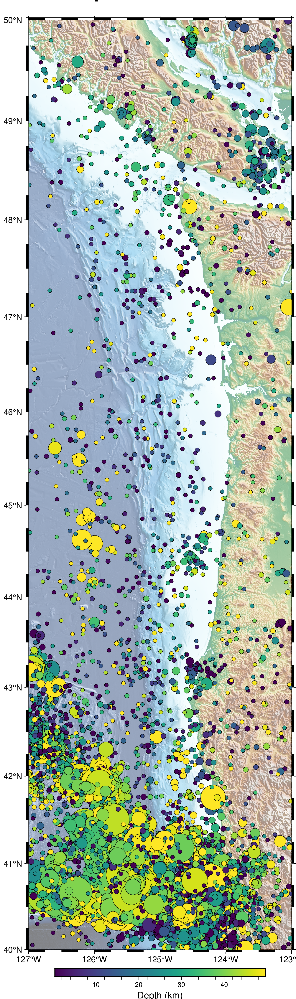

In [14]:
fig = pygmt.Figure()

picks= events['picks']

# Load grid data
grid = pygmt.datasets.load_earth_relief(resolution="15s", region=[-127, -123, 40, 50])
shade = pygmt.grdgradient(grid=grid, azimuth="0/90", normalize="t1")
# Define target region
region = [-127, -123, 40, 50]
title = "Depths of the events"

fig.basemap(region=region, projection="M12c", frame=["af", f"WSne+t{title}"])
fig.grdimage(grid=grid, cmap="geo",shading=shade, transparency=50)
# fig.basemap(region=region, projection="M15c", frame=True)
# fig.coast(land="black", water="skyblue")
pygmt.makecpt(cmap="viridis", series=[events['depth'].min(), events['depth'].max()])
fig.plot(
    x=events['longitude'],
    y=events['latitude'],
    fill=events['depth'],
    cmap=True,
    size = picks*0.03,
    style='c',
    pen="black",
)
fig.colorbar(frame="xaf+lDepth (km)")
# Plot stations
# fig.plot(x=sta_lon, y=sta_lat, fill='white', style="t0.4c", pen="black", label="Stations")

fig.show()